In [15]:
# import necessary packages
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd

### Utah County Accidents Visualization ###

In [ ]:
# set the parameters to obtain a large, high-quality image
plt.rcParams["figure.dpi"] = 440

In [17]:
# read in the Utah County Accidents data subset
uc_df = pd.read_csv("data/utah_county_accidents.csv")

# read in the file containing the road map of Utah County
uc_roads = gpd.read_file("uc_2020_roads.gpkg")

# Create the coordinates of each accident as a column
uc_df["Start Coordinates"] = list(zip(uc_df['Start_Lng'], uc_df['Start_Lat']))

In [22]:
# create the figure and plot the roads
fig, ax = plt.subplots(1, figsize=(50, 50))
uc_roads.geometry.plot(edgecolor="black", ax=ax, linewidth=0.1)

# plot each type of severity one at a time for correct layering on plot
uc_df[uc_df['Severity'] == 1].plot(kind="scatter", x="Start_Lng", 
                                   y="Start_Lat", ax=ax, c="limegreen", 
                                   alpha=.9, s=10, marker='o', 
                                   label="Severity 1", colorbar=False)

uc_df[uc_df['Severity'] == 2].plot(kind="scatter", x="Start_Lng", 
                                   y="Start_Lat", ax=ax, c="cornflowerblue", 
                                   alpha=.9, s=10, marker='o', 
                                   label="Severity 2", colorbar=False)

uc_df[uc_df['Severity'] == 3].plot(kind="scatter", x="Start_Lng", 
                                   y="Start_Lat", ax=ax, c="gold", 
                                   alpha=.9, s=10, marker='o', 
                                   label="Severity 3", colorbar=False)

uc_df[uc_df['Severity'] == 4].plot(kind="scatter", x="Start_Lng", 
                                   y="Start_Lat", ax=ax, c="darkred", 
                                   alpha=.9, s=10, marker='o', 
                                   label="Severity 4", colorbar=False)

# finish formatting and plot details
ax.set_xticks([])
ax.set_yticks([])
ax.set_title("Utah County Roads", fontsize=30)
plt.legend(fontsize=12)
plt.show()

# save the image for exportation
plt.savefig("uc_image_legend.png")
plt.close()

### Plotting F1-Scores ###


In [23]:
# read in csv files containing the macro-F1 scores from our respective tests
utah_df = pd.read_csv("./data/utah_accuracy_best.csv")
utah_county_df = pd.read_csv("./data/utah_county_accuracy_best.csv")

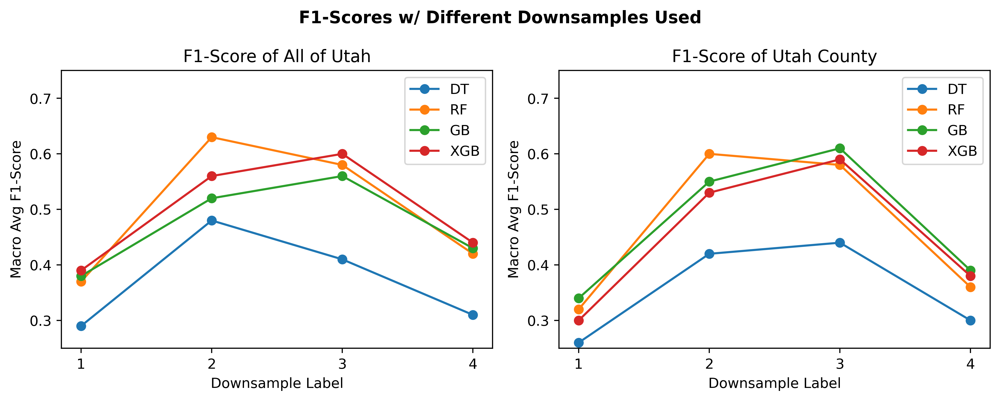

In [24]:
# change figure size and dpi
plt.rcParams['figure.figsize'] = [10, 4]
plt.rcParams['figure.dpi'] = 400

# set up axes
ax1 = plt.subplot(121)
ax2 = plt.subplot(122)

# plot the F1-scores for each model
for model in utah_df.model.unique():
    subset_utah_df = utah_df[utah_df.model == model]
    subset_uc_df = utah_county_df[utah_county_df.model == model]
    subset_utah_df.plot(x='ds_label', y='overall_f1', label=model, ax=ax1, marker='o')
    subset_uc_df.plot(x='ds_label', y='overall_f1', label=model, ax=ax2, marker='o')

# set overall plot details
x_ticks = [1, 2, 3, 4]
ylim = [0.25, 0.75]
xlabel = 'Downsample Label'
ylabel = 'Macro Avg F1-Score'
plt.suptitle('F1-Scores w/ Different Downsamples Used', weight='bold')

# plot details for all of Utah subplot
ax1.set_xticks(x_ticks)
ax1.set_ylim(ylim)
ax1.set_xlabel(xlabel)
ax1.set_ylabel(ylabel)
ax1.set_title('F1-Score of All of Utah')

# plot details for Utah County subplot
ax2.set_xticks(x_ticks)
ax2.set_ylim(ylim)
ax2.set_xlabel(xlabel)
ax2.set_ylabel(ylabel)
ax2.set_title('F1-Score of Utah County')

# finish the plot
plt.tight_layout()
plt.show()